In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

from pathlib import Path
from scipy.io import wavfile
from IPython.display import Audio

import tensorflow as tf
from tensorflow import keras

In [2]:
def load_chorales(filepaths):
    return [pd.read_csv(filepath).values.tolist() for filepath in filepaths]

jsb_chorales_dir = Path('jsb_chorales')
train_files = sorted(jsb_chorales_dir.glob('train/chorale_*.csv'))
valid_files = sorted(jsb_chorales_dir.glob('valid/chorale_*.csv'))
test_files = sorted(jsb_chorales_dir.glob('test/chorale_*.csv'))

train_chorales = load_chorales(train_files + test_files)
valid_chorales = load_chorales(valid_files)

In [3]:
# Notes range from 36 (C1 = C on octave 1) to 81 (A5 = A on octave 5), plus 0 for silence...

notes = set()
for chorales in (train_chorales, valid_chorales):
    for chorale in chorales:
        for chord in chorale:
            notes |= set(chord)

n_notes = len(notes)
min_note = min(notes - {0})
max_note = max(notes)

assert min_note == 36
assert max_note == 81

In [4]:
# Some functions for listening to the chorales...

def notes_to_frequencies(notes):
    # Frequency doubles when you go up one octave; there are 12 semi-tones
    # per octave; Note A on octave 4 is 440 Hz, and it is note number 69.
    return 2 ** ((np.array(notes) - 69) / 12) * 440

def frequencies_to_samples(frequencies, tempo, sample_rate):
    note_duration = 60 / tempo # the tempo is measured in beats per minutes
    # To reduce click sound at every beat, we round the frequencies to try to
    # get the samples close to zero at the end of each note.
    frequencies = np.round(note_duration * frequencies) / note_duration
    n_samples = int(note_duration * sample_rate)
    time = np.linspace(0, note_duration, n_samples)
    sine_waves = np.sin(2 * np.pi * frequencies.reshape(-1, 1) * time)
    # Removing all notes with frequencies ≤ 9 Hz (includes note 0 = silence)
    sine_waves *= (frequencies > 9.).reshape(-1, 1)
    return sine_waves.reshape(-1)

def chords_to_samples(chords, tempo, sample_rate):
    freqs = notes_to_frequencies(chords)
    freqs = np.r_[freqs, freqs[-1:]] # make last note a bit longer
    merged = np.mean([frequencies_to_samples(melody, tempo, sample_rate)
                     for melody in freqs.T], axis=0)
    n_fade_out_samples = sample_rate * 60 // tempo # fade out last note
    fade_out = np.linspace(1., 0., n_fade_out_samples)**2
    merged[-n_fade_out_samples:] *= fade_out
    return merged

def play_chords(chords, tempo=160, amplitude=0.1, sample_rate=44100, filepath=None):
    samples = amplitude * chords_to_samples(chords, tempo, sample_rate)
    if filepath:
        samples = (2**15 * samples).astype(np.int16)
        wavfile.write(filepath, sample_rate, samples)
        return display(Audio(filepath))
    else:
        return display(Audio(samples, rate=sample_rate))

In [5]:
play_chords(train_chorales[0])

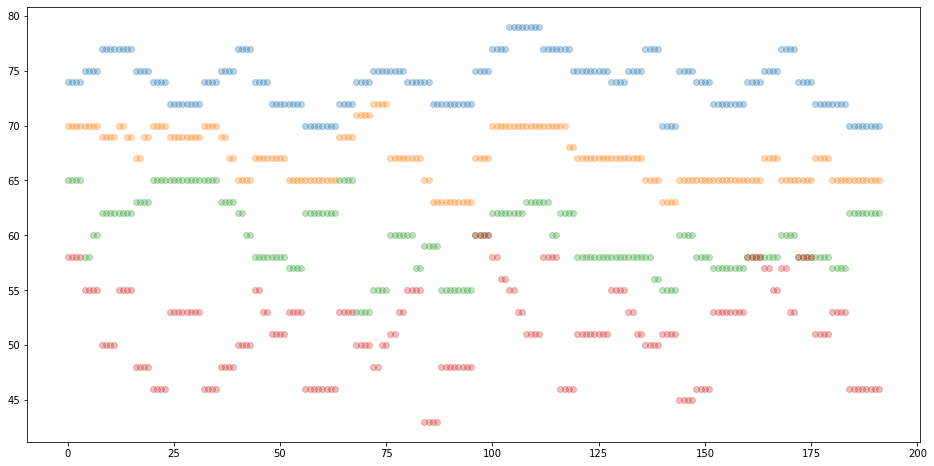

In [6]:
# Visualize a chorale...

v = np.array(train_chorales[0])
v0 = v[:, 0]
v1 = v[:, 1]
v2 = v[:, 2]
v3 = v[:, 3]
x = np.arange(0, len(v), 1)

fig, ax = plt.subplots(figsize=(16,8))
ax.scatter(x, v0, marker='o', alpha=0.3)
ax.scatter(x, v1, marker='o', alpha=0.3)
ax.scatter(x, v2, marker='o', alpha=0.3)
ax.scatter(x, v3, marker='o', alpha=0.3)

In order to be able to generate new chorales, we want to train a model that can predict the next chord given all the previous chords. If we naively try to predict the next chord in one shot, predicting all 4 notes at once, we run the risk of getting notes that don't go very well together. It's much better and simpler to predict one note at a time. So we will need to preprocess every chorale, turning each chord into an arpegio (i.e., a sequence of notes rather than notes played simultaneuously). So each chorale will be a long sequence of notes (rather than chords), and we can just train a model that can predict the next note given all the previous notes. We will use a sequence-to-sequence approach, where we feed a window to the neural net, and it tries to predict that same window shifted one time step into the future. We will also shift the values so that they range from 0 to 46, where 0 represents silence, and values 1 to 46 represent notes 36 (C1) to 81 (A5). And we will train the model on windows of 128 notes (i.e., 32 chords).

In [7]:
def create_target(batch):
    X = batch[:, :-1]
    Y = batch[:, 1:] # predict next note in each arpegio, at each step
    return X, Y

def preprocess(window):
    window = tf.where(window == 0, window, window - min_note + 1) # shift values
    return tf.reshape(window, [-1]) # convert to arpegio

def bach_dataset(chorales, batch_size=32, shuffle_buffer_size=None,
                 window_size=32, window_shift=16, cache=True):
    def batch_window(window):
        return window.batch(window_size + 1)

    def to_windows(chorale):
        dataset = tf.data.Dataset.from_tensor_slices(chorale)
        dataset = dataset.window(window_size + 1, window_shift, drop_remainder=True)
        return dataset.flat_map(batch_window)

    chorales = tf.ragged.constant(chorales, ragged_rank=1)
    dataset = tf.data.Dataset.from_tensor_slices(chorales)
    dataset = dataset.flat_map(to_windows).map(preprocess)
    if cache:
        dataset = dataset.cache()
    if shuffle_buffer_size:
        dataset = dataset.shuffle(shuffle_buffer_size)
    dataset = dataset.batch(batch_size)
    dataset = dataset.map(create_target)
    return dataset.prefetch(1)

In [9]:
train_set = bach_dataset(train_chorales, shuffle_buffer_size=1000)
valid_set = bach_dataset(valid_chorales)

Now let's create the model:

- We could feed the note values directly to the model, as floats, but this would probably not give good results. Indeed, the relationships between notes are not that simple: for example, if you replace a C3 with a C4, the melody will still sound fine, even though these notes are 12 semi-tones apart (i.e., one octave). Conversely, if you replace a C3 with a C#3, it's very likely that the chord will sound horrible, despite these notes being just next to each other. So we will use an Embedding layer to convert each note to a small vector representation. We will use 5-dimensional embeddings, so the output of this first layer will have a shape of [batch_size, window_size, 5].
- We will then feed this data to a small WaveNet-like neural network, composed of a stack of 4 Conv1D layers with doubling dilation rates. We will intersperse these layers with BatchNormalization layers for faster better convergence.
- Then one LSTM layer to try to capture long-term patterns.
- And finally a Dense layer to produce the final note probabilities. It will predict one probability for each chorale in the batch, for each time step, and for each possible note (including silence). So the output shape will be [batch_size, window_size, 47].

In [10]:
n_embedding_dims = 5

model = keras.models.Sequential([
    keras.layers.Embedding(input_dim=n_notes, output_dim=n_embedding_dims,
                           input_shape=[None]),
    keras.layers.Conv1D(32, kernel_size=2, padding="causal", activation="relu"),
    keras.layers.BatchNormalization(),
    keras.layers.Conv1D(48, kernel_size=2, padding="causal", activation="relu", dilation_rate=2),
    keras.layers.BatchNormalization(),
    keras.layers.Conv1D(64, kernel_size=2, padding="causal", activation="relu", dilation_rate=4),
    keras.layers.BatchNormalization(),
    keras.layers.Conv1D(96, kernel_size=2, padding="causal", activation="relu", dilation_rate=8),
    keras.layers.BatchNormalization(),
    keras.layers.LSTM(256, return_sequences=True),
    keras.layers.Dense(n_notes, activation="softmax")
])

model.summary()

Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
embedding (Embedding)        (None, None, 5)           235       
_________________________________________________________________
conv1d (Conv1D)              (None, None, 32)          352       
_________________________________________________________________
batch_normalization (BatchNo (None, None, 32)          128       
_________________________________________________________________
conv1d_1 (Conv1D)            (None, None, 48)          3120      
_________________________________________________________________
batch_normalization_1 (Batch (None, None, 48)          192       
_________________________________________________________________
conv1d_2 (Conv1D)            (None, None, 64)          6208      
_________________________________________________________________
batch_normalization_2 (Batch (None, None, 64)          2

In [11]:
early_stop_cb = keras.callbacks.EarlyStopping(patience=10, restore_best_weights=True)

optimizer = keras.optimizers.Nadam(learning_rate=1e-3)
model.compile(loss="sparse_categorical_crossentropy", optimizer=optimizer, metrics=["accuracy"])
model.fit(train_set, epochs=50, validation_data=valid_set, callbacks=[early_stop_cb])

Epoch 1/50
131/131 [==============================] - 24s 157ms/step - loss: 1.6548 - accuracy: 0.5816 - val_loss: 3.8071 - val_accuracy: 0.0535
Epoch 2/50
131/131 [==============================] - 19s 146ms/step - loss: 0.8244 - accuracy: 0.7762 - val_loss: 4.3935 - val_accuracy: 0.0164
Epoch 3/50
131/131 [==============================] - 21s 157ms/step - loss: 0.7027 - accuracy: 0.8008 - val_loss: 3.0800 - val_accuracy: 0.2069
Epoch 4/50
131/131 [==============================] - 24s 184ms/step - loss: 0.6307 - accuracy: 0.8161 - val_loss: 1.5342 - val_accuracy: 0.5494
Epoch 5/50
131/131 [==============================] - 29s 225ms/step - loss: 0.5780 - accuracy: 0.8281 - val_loss: 0.7270 - val_accuracy: 0.7942
Epoch 6/50
131/131 [==============================] - 24s 180ms/step - loss: 0.5341 - accuracy: 0.8389 - val_loss: 0.6101 - val_accuracy: 0.8220
Epoch 7/50
131/131 [==============================] - 28s 215ms/step - loss: 0.4975 - accuracy: 0.8479 - val_loss: 0.5771 - val_ac

Now let's write a function that will generate a new chorale. We will give it a few seed chords, it will convert them to arpegios (the format expected by the model), and use the model to predict the next note, then the next, and so on. In the end, it will group the notes 4 by 4 to create chords again, and return the resulting chorale.

In [12]:
def generate_chorale(model, seed_chords, length):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note = np.argmax(model.predict(arpegio), axis=-1)[:1, -1:]
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

In [16]:
seed_chords = valid_chorales[3][:12]
play_chords(seed_chords, amplitude=0.2)

In [18]:
new_chorale = generate_chorale(model, seed_chords, 68)
play_chords(new_chorale)

This approach has one major flaw: it is often too conservative. Indeed, the model will not take any risk, it will always choose the note with the highest score, and since repeating the previous note generally sounds good enough, it's the least risky option, so the algorithm will tend to make notes last longer and longer. Pretty boring. Plus, if you run the model multiple times, it will always generate the same melody.

So let's spice things up a bit! Instead of always picking the note with the highest score, we will pick the next note randomly, according to the predicted probabilities. For example, if the model predicts a C3 with 75% probability, and a G3 with a 25% probability, then we will pick one of these two notes randomly, with these probabilities. We will also add a temperature parameter that will control how "hot" (i.e., daring) we want the system to feel. A high temperature will bring the predicted probabilities closer together, reducing the probability of the likely notes and increasing the probability of the unlikely ones.

In [19]:
def generate_chorale_v2(model, seed_chords, length, temperature=1):
    arpegio = preprocess(tf.constant(seed_chords, dtype=tf.int64))
    arpegio = tf.reshape(arpegio, [1, -1])
    for chord in range(length):
        for note in range(4):
            next_note_probas = model.predict(arpegio)[0, -1:]
            rescaled_logits = tf.math.log(next_note_probas) / temperature
            next_note = tf.random.categorical(rescaled_logits, num_samples=1)
            arpegio = tf.concat([arpegio, next_note], axis=1)
    arpegio = tf.where(arpegio == 0, arpegio, arpegio + min_note - 1)
    return tf.reshape(arpegio, shape=[-1, 4])

In [20]:
new_chorale_v2_cold = generate_chorale_v2(model, seed_chords, 68, temperature=0.8)
play_chords(new_chorale_v2_cold)

In [21]:
new_chorale_v2_medium = generate_chorale_v2(model, seed_chords, 68, temperature=1.0)
play_chords(new_chorale_v2_medium)

In [22]:
new_chorale_v2_hot = generate_chorale_v2(model, seed_chords, 68, temperature=1.5)
play_chords(new_chorale_v2_hot)

In [23]:
new_chorale_v2_boiling = generate_chorale_v2(model, seed_chords, 68, temperature=2.0)
play_chords(new_chorale_v2_boiling)

In [24]:
new_chorale_v2_silly = generate_chorale_v2(model, seed_chords, 68, temperature=3.0)
play_chords(new_chorale_v2_silly)

In [25]:
new_chorale_v2_final = generate_chorale_v2(model, seed_chords, 68, temperature=10.0)
play_chords(new_chorale_v2_final)